# Capstone: Airbnb Price Listing Prediction
## Part 2 Full Exploratory Data Analysis

_Authors: Evonne Tham_

In this notebook, I will be doing a full eda given that the data is now clean. I can now maximize the insight into this data set and its underlying structure. On top of that Geographical, and geospatial analysis will be done so here.


## Contents of this notebook
- [1. Import Necessary Libraries and Load Data](#1.-Import-Necessary-Libraries-and-Load-Data)
- [2. Full Exploratory Analysis](#2.-Full-Exploratory-Analysis)
- [3. Geographical Analysis](#3.-Geographical-Analysis)
- [4. Geospatial Analysis](#4.-Geospatial-Analysis)
    - [4.1. Property Type](#4.1.-Property-Type)
    - [4.2. Room Type](#4.2.-Room-Type)
    - [4.3. Listing Density](#4.3.-Listing-Density) 
    - [4.4. Average Price Density](#4.4.-Average-Price-Density)
- [5. Heatmap of Correlation Matrix](#5.-Heatmap-of-Correlation-Matrix)    

##  1. Import Necessary Libraries and Load Data 

In [1]:
import pandas as pd
import numpy as np

# Plots
import matplotlib.pyplot as plt
import seaborn as sns   
%matplotlib inline

# Geographical/geospatial Analysis
import geopandas as gpd
from shapely.geometry import Point, shape
import folium
from folium import plugins
from folium.plugins import HeatMap
import plotly.graph_objects as go
from plotly.offline import iplot

#Hide warnings
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Load in Data 
final = pd.read_csv('../datasets/final.csv')
print(f"Total Number of Listing: {final.shape[0]} | Total Number of Features: {final.shape[1]}")
final.head(3).T

Total Number of Listing: 14953 | Total Number of Features: 39


,0,1,2
id,35303,197677,289597
host_id,151977,964081,341577
host_since,2010-06-25,2011-08-13,2011-01-10
host_response_time,unknown,within a few hours,within a few hours
host_response_rate,unknown,100%,100%
host_acceptance_rate,unknown,50-89%,50-89%
host_is_superhost,0,1,0
host_listings_count,3,1,2
host_identity_verified,1,1,1
neighbourhood,Shibuya Ku,Sumida Ku,Nerima Ku


In [3]:
final.describe().T

,count,mean,std,min,25%,50%,75%,max
id,14953.0,3.169330e+07,9.428992e+06,35303.00000,2.649812e+07,3.343399e+07,3.963909e+07,4.357856e+07
host_id,14953.0,1.702688e+08,1.003230e+08,151977.00000,7.061679e+07,1.857782e+08,2.528881e+08,3.469412e+08
host_is_superhost,14953.0,3.380593e-01,4.730646e-01,0.00000,0.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00
host_listings_count,14953.0,1.508761e+01,2.296383e+01,0.00000,3.000000e+00,7.000000e+00,1.700000e+01,1.360000e+02
host_identity_verified,14953.0,1.872534e-01,3.901278e-01,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00
latitude,14953.0,3.569467e+01,1.442429e-01,27.07233,3.568580e+01,3.570280e+01,3.572464e+01,3.583243e+01
longitude,14953.0,1.397348e+02,8.173301e-02,139.12319,1.396993e+02,1.397281e+02,1.397849e+02,1.422029e+02
is_location_exact,14953.0,8.092022e-01,3.929432e-01,0.00000,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00
accommodates,14953.0,4.422858e+00,3.163623e+00,1.00000,2.000000e+00,4.000000e+00,6.000000e+00,1.600000e+01
bathrooms,14953.0,1.251856e+00,1.122914e+00,0.00000,1.000000e+00,1.000000e+00,1.000000e+00,5.000000e+01


---
##  2. Full Exploratory Analysis

##### Price (Target Variable)

In [4]:
print(f"Nightly advertised prices range from {min(final.price)}¥ to {max(final.price)}¥.")

Nightly advertised prices range from 1075¥ to 1066134¥.


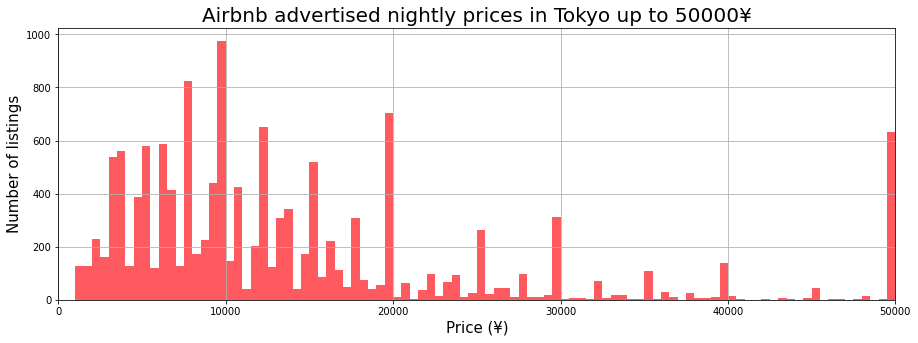

In [5]:
# Distribution of prices up to 50_000 yen 
plt.figure(figsize=(15,5))

final.price.hist(bins=100, 
                 range=(0, 50_000),
                 color ='#FF5A5F')

plt.margins(x=0)
plt.title("Airbnb advertised nightly prices in Tokyo up to 50000¥", fontsize=20)
plt.xlabel("Price (¥)", fontsize=15)
plt.ylabel("Number of listings", fontsize=15);

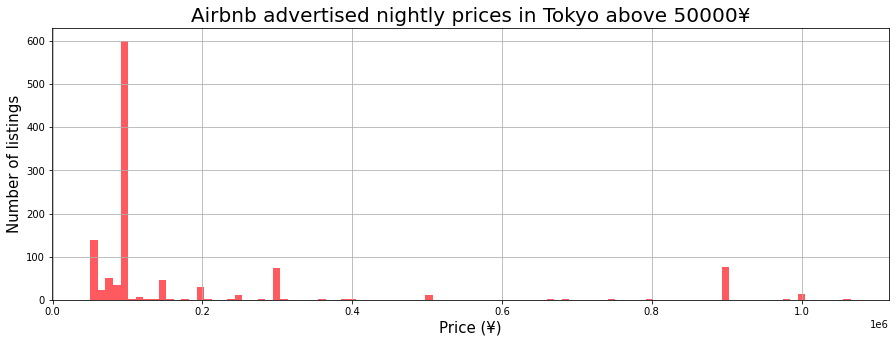

In [6]:
# Distribution of prices up to 50_000 yen 
plt.figure(figsize=(15,5))

final.price.hist(bins=100, 
                 range=(50_000, max(final.price)),
                 color ='#FF5A5F')

plt.title("Airbnb advertised nightly prices in Tokyo above 50000¥", fontsize=20)
plt.xlabel("Price (¥)", fontsize=15)
plt.ylabel("Number of listings", fontsize=15);

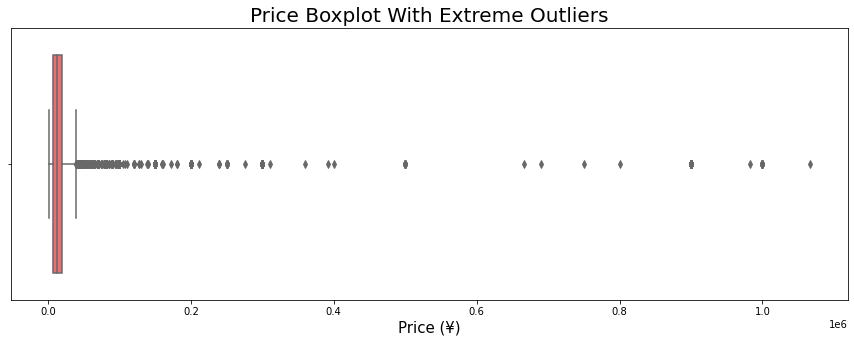

In [7]:
plt.figure(figsize =(15,5))

sns.boxplot(final.price, color = '#FF5A5F')
plt.title('Price Boxplot With Extreme Outliers', fontsize=20)
plt.xlabel('Price (¥)', fontsize = 15);

_Number of outliers is significant. However there are quite a number of listing that are price above 100000 yen. Hence I will be leaving those untouch and drop those that are priced above that and are of lesser frequency._


<img src="../image/listing_over_100000.png"
	title="Listing over 100000¥" width="1050" height="1000" />

In [8]:
# Drop rows that are listed above 100000 Yen
final.drop(final[final['price'] > 100_000].index, inplace=True)

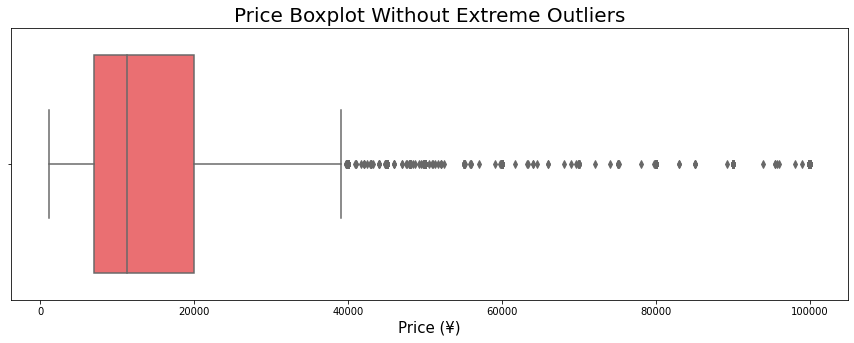

In [9]:
plt.figure(figsize =(15,5))

sns.boxplot(final.price, color = '#FF5A5F')
plt.title('Price Boxplot Without Extreme Outliers', fontsize=20)
plt.xlabel('Price (¥)', fontsize = 15);

Outlier is significantly lesser. But the above distribution graph is still a right-skewed distribution on price. This means there is a positive skewness. Log transformation will be used to make this feature less skewed. This will help to make easier interpretation and better statistical analysis

The above distribution graph shows that there is a right-skewed distribution on price. This means there is a positive skewness. Log transformation will be used to make this feature less skewed. There might be a possibility that it will help to make easier interpretation and better statistical analysis. Further analysis will be required (which will be touched on later in the project)

In [10]:
final['log_price'] = np.log(final.price)

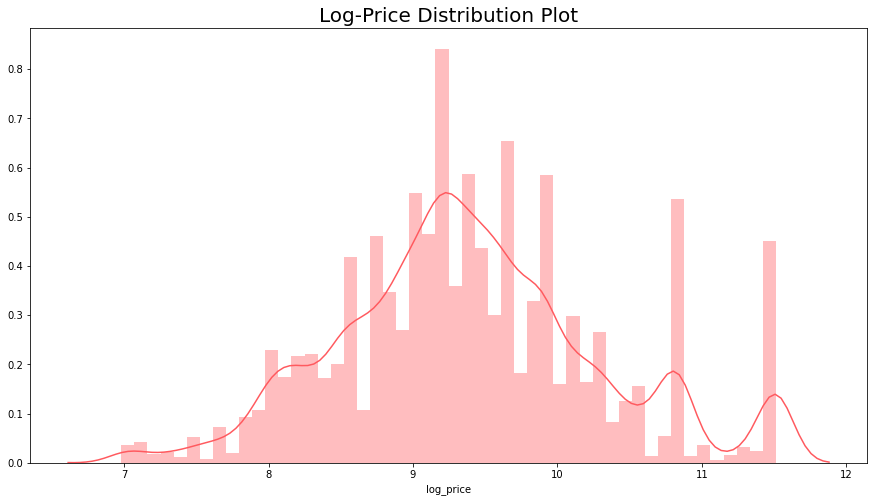

In [11]:
plt.figure(figsize=(15,8))
sns.distplot(final['log_price'], color = '#FF5A5F')
plt.title("Log-Price Distribution Plot",size=20);

---
##### Host

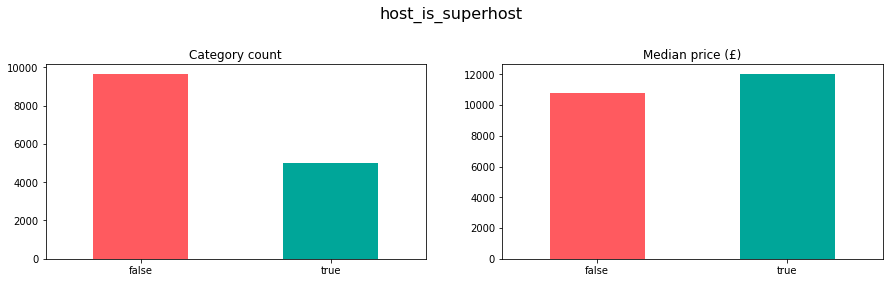

0    0.659638
1    0.340362
Name: host_is_superhost, dtype: float64


In [12]:
def binary_count_and_price_plot(col, figsize=(15,4)):
    """
    Plots a simple bar chart of the counts of true and false categories in the column specified,
    next to a bar chart of the median price for each category.
    A figure size can optionally be specified.
    """
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=figsize)
    fig.suptitle(col, fontsize=16, y=1)
    plt.subplots_adjust(top=0.80) # So that the suptitle does not overlap with the ax plot titles
    
    final.groupby(col).size().plot(kind='bar', ax=ax1, color=['#FF5A5F', '#00A699'])
    ax1.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax1.set_title('Category count')
    ax1.set_xlabel('')
    
    final.groupby(col).price.median().plot(kind='bar', ax=ax2, color=['#FF5A5F', '#00A699'])
    ax2.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax2.set_title('Median price (£)')
    ax2.set_xlabel('')
    
    plt.show()

binary_count_and_price_plot('host_is_superhost')
print(final.host_is_superhost.value_counts(normalize=True));

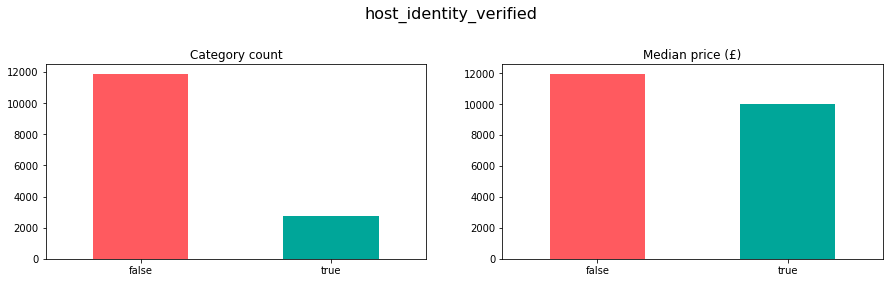

0    0.811737
1    0.188263
Name: host_identity_verified, dtype: float64


In [13]:
binary_count_and_price_plot('host_identity_verified')
print(final.host_identity_verified.value_counts(normalize=True));

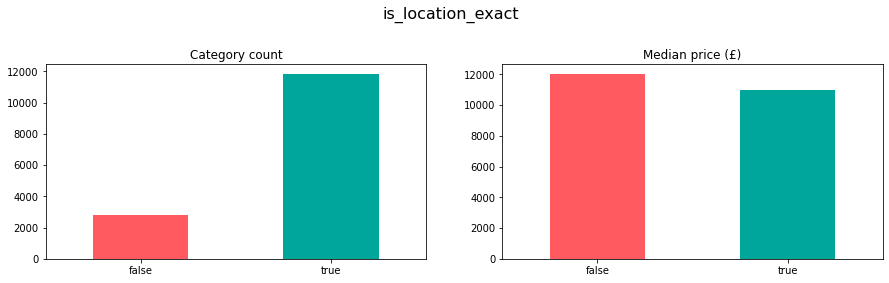

1    0.808666
0    0.191334
Name: is_location_exact, dtype: float64


In [14]:
binary_count_and_price_plot('is_location_exact')
print(final.is_location_exact.value_counts(normalize=True));

Observation: About 37% of hosts are superhosts and about 20% of hosts are verified. However, it does not seem to improve the median price per night of their Airbnb listings. There is not much difference as well for whether is location is exact.

---
##### Host Listing Count

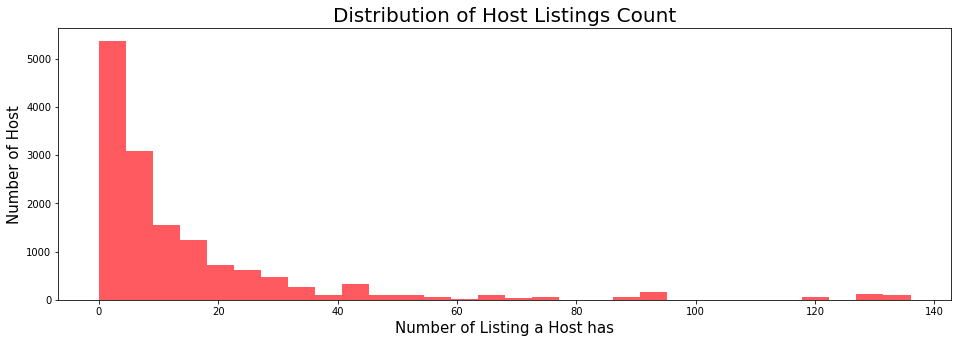

In [15]:
plt.figure(figsize=(16,5))
plt.hist(final['host_listings_count'], bins=30, color ='#FF5A5F')
plt.title('Distribution of Host Listings Count', fontsize=20)
plt.xlabel('Number of Listing a Host has', fontsize=15)
plt.ylabel('Number of Host', fontsize=15);

Listing which leaves host with zero listing counts will be dropped. Assumption being these users signed up as host but have yet to list any property. Hence, it will not affect the prediction.

In [16]:
final[final['host_listings_count']==0]

,id,host_id,host_since,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_listings_count,host_identity_verified,neighbourhood,...,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,cancellation_policy,log_price
18,1394409,7537357,2013-07-17,within a few hours,100%,0-49%,0,0,0,Toshima Ku,...,90-99%,10,9,10,10,10,10,0,moderate,8.078688
19,1394737,7537357,2013-07-17,within a few hours,100%,0-49%,0,0,0,Toshima Ku,...,90-99%,10,10,10,10,10,10,0,moderate,7.673223
50,2839061,4839990,2013-01-25,unknown,unknown,50-89%,1,0,0,Bunkyo Ku,...,90-99%,10,10,10,10,10,10,0,strict,8.609225
151,5198467,25911199,2015-01-10,within a few hours,100%,50-89%,0,0,1,Bunkyo Ku,...,90-99%,10,10,10,10,9,10,0,strict,10.166429
532,10110295,46443714,2015-10-13,within a day,100%,50-89%,0,0,1,Shibuya Ku,...,90-99%,9,9,9,10,10,9,0,moderate,9.108308
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14931,43537509,346941174,2020-05-20,within an hour,100%,100%,0,0,0,Shibuya Ku,...,unrated,unrated,unrated,unrated,unrated,unrated,unrated,1,moderate,8.851807
14932,43537601,346941174,2020-05-20,within an hour,100%,100%,0,0,0,Shibuya Ku,...,unrated,unrated,unrated,unrated,unrated,unrated,unrated,1,moderate,9.210040
14946,43570854,297814070,2019-09-25,within an hour,100%,100%,1,0,0,Toshima Ku,...,unrated,unrated,unrated,unrated,unrated,unrated,unrated,1,flexible,11.289532
14947,43571190,297814070,2019-09-25,within an hour,100%,100%,1,0,0,Toshima Ku,...,unrated,unrated,unrated,unrated,unrated,unrated,unrated,1,flexible,11.289819


In [17]:
final.drop(final[final['host_listings_count']==0].index, inplace=True)
final.shape

(13516, 40)

In [18]:
print("Median number of listings per host:", int(final.host_listings_count.median()))
print("Mean number of listings per host:", int(round(final.host_listings_count.mean())))
print(f"{int(round(100*len(final[final.host_listings_count == 1])/len(final)))}% of listings are from hosts with one listing.")

Median number of listings per host: 8
Mean number of listings per host: 16
10% of listings are from hosts with one listing.


 According to the numbers above, it seems like hosts in Tokyo manages quite a number of properties. 

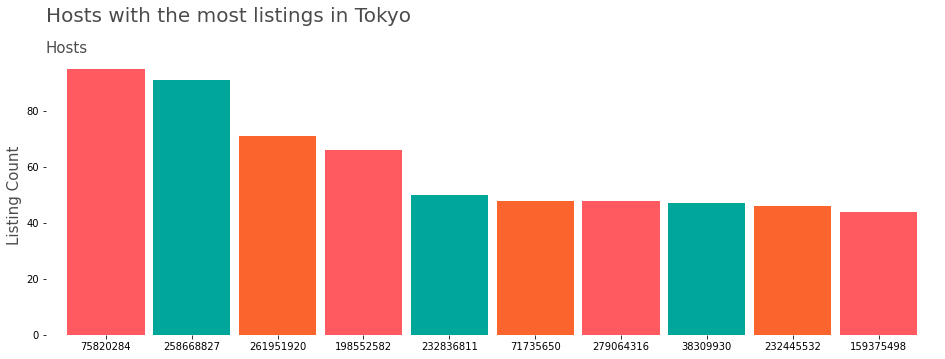

In [19]:
top_host=final.host_id.value_counts().head(10)

fig = plt.figure(1, figsize=(16,5))
ax = fig.add_subplot(111)

title = 'Hosts with the most listings in Tokyo'

transparency = 0.7
color = ['#FF5A5F', '#00A699', '#FC642D']

top_host.plot(kind = 'bar', 
              color = color, 
              width = 0.9,
              title = title)

ax.grid(False)
ax.set_frame_on(False)

ax.set_title(ax.get_title(), fontsize=20, alpha=transparency, ha='left')
plt.subplots_adjust(top=0.9)
ax.title.set_position((0,1.1))

ax.xaxis.set_label_position('top')
xlab = 'Hosts'
ax.set_xlabel(xlab, fontsize=15, alpha=transparency, ha='left')
ax.xaxis.set_label_coords(0, 1.01)
plt.xticks(rotation=0)

ylab = 'Listing Count'
ax.set_ylabel(ylab, fontsize=15, alpha=transparency);

These are the host with most number of listing in Tokyo. This might just be professional Airbnb management companies which host a large number of listings under a single host profile, particularly the Host 75820284 that manages over 80 listings 

---
##### Neighbourhod

In [20]:
# Create new dataframe for neighbourhood count
neighbourhood_count = pd.DataFrame()
neighbourhood_count['total_hosts'] = final['neighbourhood'].value_counts()

# Filter out neighbourhood with less than 20 listings
neighbourhood_count = neighbourhood_count[neighbourhood_count['total_hosts'] > 20]
neighbourhood_count.sort_index(ascending=True, inplace=True)

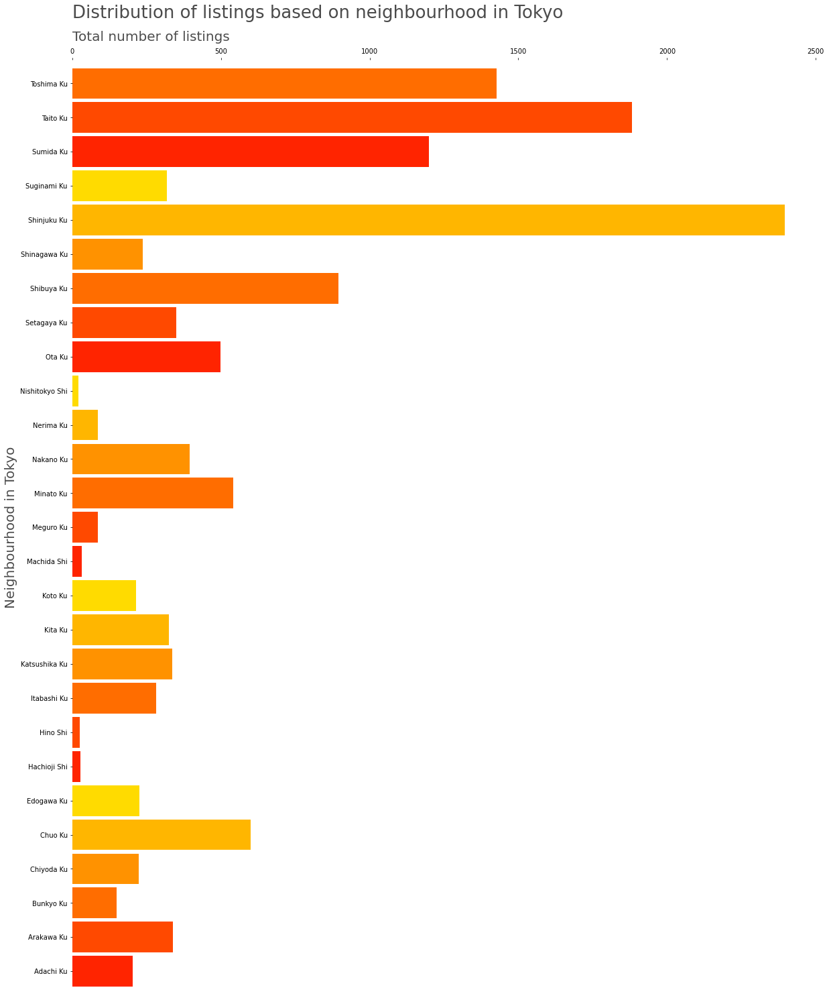

In [21]:
fig = plt.figure(1, figsize=(20,25))
ax = fig.add_subplot(111)

title="Distribution of listings based on neighbourhood in Tokyo"

transparency = 0.7
cmap = sns.color_palette("autumn")

neighbourhood_count['total_hosts'].plot(kind = 'barh',
                                        ax = ax,
                                        color = cmap,
                                        title = title, 
                                        width = 0.9)

ax.grid(False)
ax.set_frame_on(False)

ax.set_title(ax.get_title(), fontsize=26, alpha=transparency, ha='left')
plt.subplots_adjust(top=0.9)
ax.title.set_position((0,1.04))

ax.xaxis.set_label_position('top')
xlab = 'Total number of listings'
ax.set_xlabel(xlab, fontsize=20, alpha=transparency, ha='left')
ax.xaxis.set_label_coords(0, 1.02)
ax.xaxis.tick_top()

ylab = 'Neighbourhood in Tokyo'
ax.set_ylabel(ylab, fontsize=20, alpha=transparency);

Shinjuku Kuhas the most Airbnb properties, followed by Taito, Toshima Ku, Sumida Ku and Shibuya Ku. Inner Tokyo wards have significantly more listings than outer wards in Tokyo. Just Shinjuku alone, there are over 2000 listings, which is not surprising as Shinjuku Ku is one of the most popular spots to visit whether for tourist or locals.


---
##### Property Type

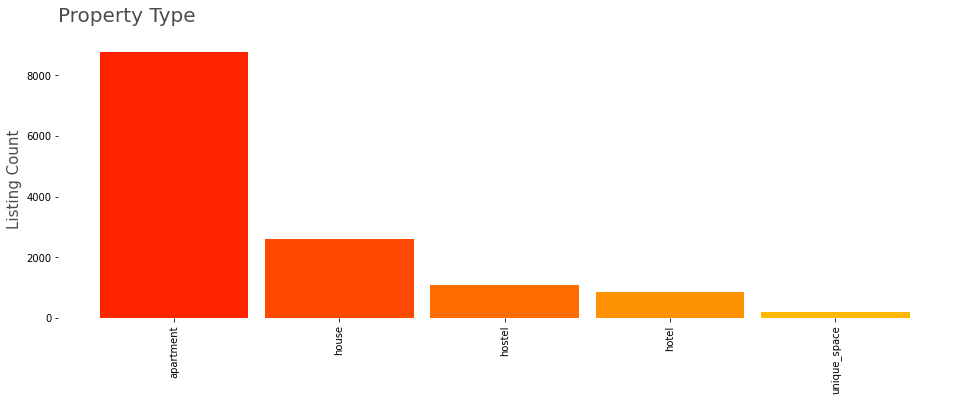

In [22]:
fig = plt.figure(1, figsize=(16,5))
ax = fig.add_subplot(111)

title = 'Property Type'

transparency = 0.7
color = sns.color_palette("autumn")

final['property_type'].value_counts().plot(kind='bar', 
                                           color = color, 
                                           width = 0.9,
                                           title = title)

ax.grid(False)
ax.set_frame_on(False)

ax.set_title(ax.get_title(), fontsize=20, alpha=transparency, ha='left')
plt.subplots_adjust(top=0.9)
ax.title.set_position((0,1.04))

ylab = 'Listing Count'
ax.set_ylabel(ylab, fontsize=15, alpha=transparency);

In [23]:
print(final.property_type.value_counts(normalize=True))

apartment       0.648269
house           0.192956
hostel          0.080793
hotel           0.063184
unique_space    0.014797
Name: property_type, dtype: float64


Observation: Most common listings property type: Apartment (More than 64%)

---
##### Room Type

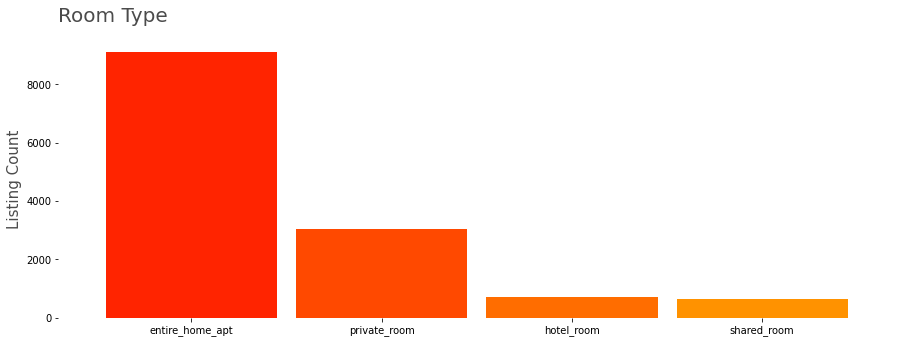

In [24]:
fig = plt.figure(1, figsize=(15,5))
ax = fig.add_subplot(111)

title = 'Room Type'

transparency = 0.7
color = sns.color_palette("autumn")

final['room_type'].value_counts().plot(kind='bar',
                                       color = color,
                                       width = 0.9, 
                                       title = title)

ax.grid(False)
ax.set_frame_on(False)

ax.set_title(ax.get_title(), fontsize=20, alpha=transparency, ha='left')
plt.subplots_adjust(top=0.9)
ax.title.set_position((0,1.04))
plt.xticks(rotation=0)

ylab = 'Listing Count'
ax.set_ylabel(ylab, fontsize=15, alpha=transparency);
print()

In [25]:
print(final.room_type.value_counts(normalize=True))

entire_home_apt    0.672906
private_room       0.226102
hotel_room         0.052678
shared_room        0.048313
Name: room_type, dtype: float64


Observation: With more than 11000 listing, about 8000 of them are entire_home_apt and only 20% are private room. 

---
##### Property Vs Room Type

In [26]:
# Create a dataframe with property_type and room_type
property_room = final.groupby(['property_type','room_type']).room_type.count().unstack()

# Sum up the total number of room types in a property type
property_room['total'] = property_room.iloc[:,0:4].sum(axis = 1)
property_room.sort_values(by='total', inplace=True)

# Filter out properties that are less than 100
property_room = property_room[property_room['total']>=100]
property_room = property_room.drop(['total'], axis=1)

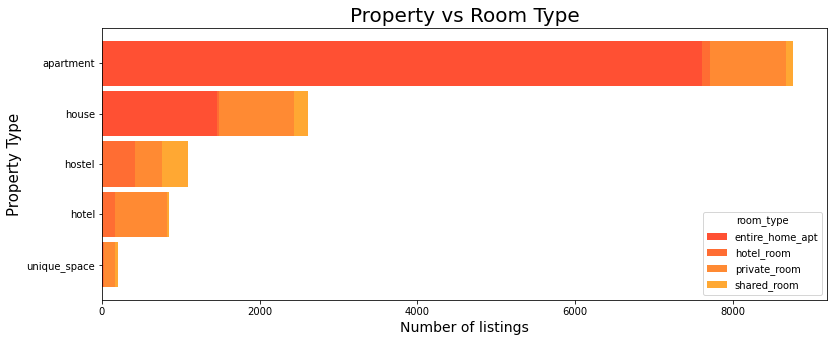

In [27]:
color = sns.color_palette("autumn")

property_room.plot(kind='barh',
                   stacked=True, 
                   color = color,
                   width=0.9,
                   figsize=(13,5), 
                   alpha = 0.8)

plt.title('Property vs Room Type', fontsize=20)
plt.xlabel('Number of listings', fontsize=14)
plt.ylabel("Property Type", fontsize=15);

Observation: As shown in the figure above, most listings are categorised as apartments which comes in 3 top room types which are entire home, hotel room, and private room

---
##### Accomodates

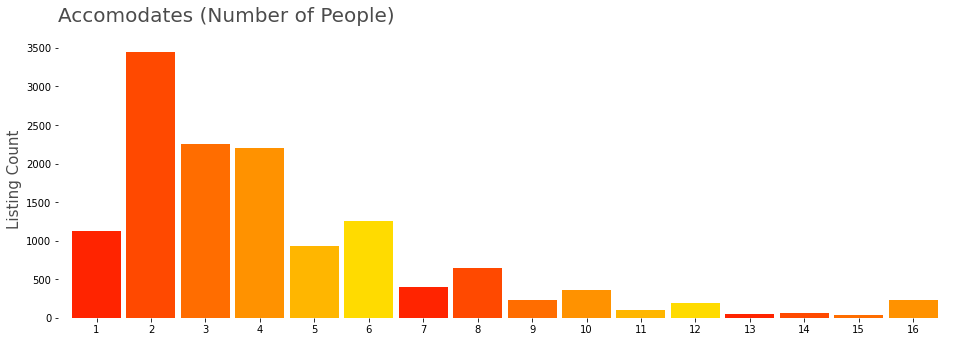

In [28]:
fig = plt.figure(1, figsize=(16,5))
ax = fig.add_subplot(111)

title = 'Accomodates (Number of People)'

transparency = 0.7
color = sns.color_palette("autumn")

final['accommodates'].value_counts().sort_index().plot(kind='bar', 
                                             color = color, 
                                             width = 0.9, 
                                             title = title)

ax.grid(False)
ax.set_frame_on(False)

ax.set_title(ax.get_title(), fontsize=20, alpha=transparency, ha='left')
plt.subplots_adjust(top=0.9)
ax.title.set_position((0,1.04))
plt.xticks(rotation=0)

ylab = 'Listing Count'
ax.set_ylabel(ylab, fontsize=15, alpha=transparency);

Observation: Most listings in Tokyo are for 2-4 people

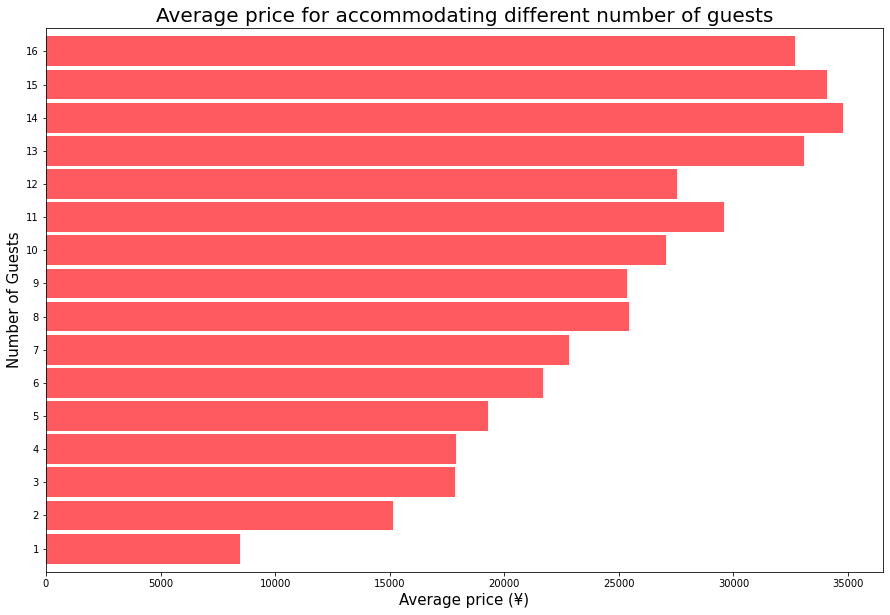

In [29]:
plt.figure(figsize=(15, 10))

color = '#FF5A5F'

final.groupby('accommodates').price.mean().plot.barh(color = color, 
                                                     width=0.9)

plt.title("Average price for accommodating different number of guests", fontsize=20)
plt.xlabel('Average price (¥)', fontsize=15)
plt.ylabel('Number of Guests', fontsize=15);

Unsurprisingly, properties that accommodate more people achieve noticeably higher nightly rates, with diminishing returns coming after about 10-11 people.

---
##### Rooms

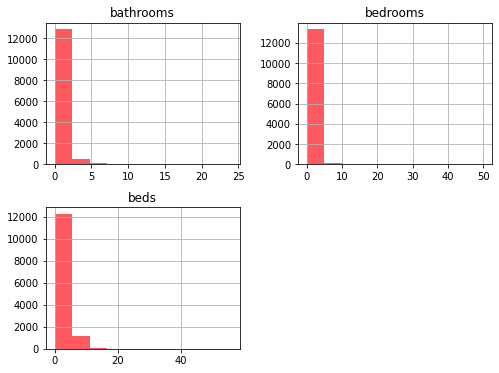

In [30]:
final[['bathrooms', 'bedrooms', 'beds']].hist(figsize=(8,6), color = '#FF5A5F');

##### Review_Scores

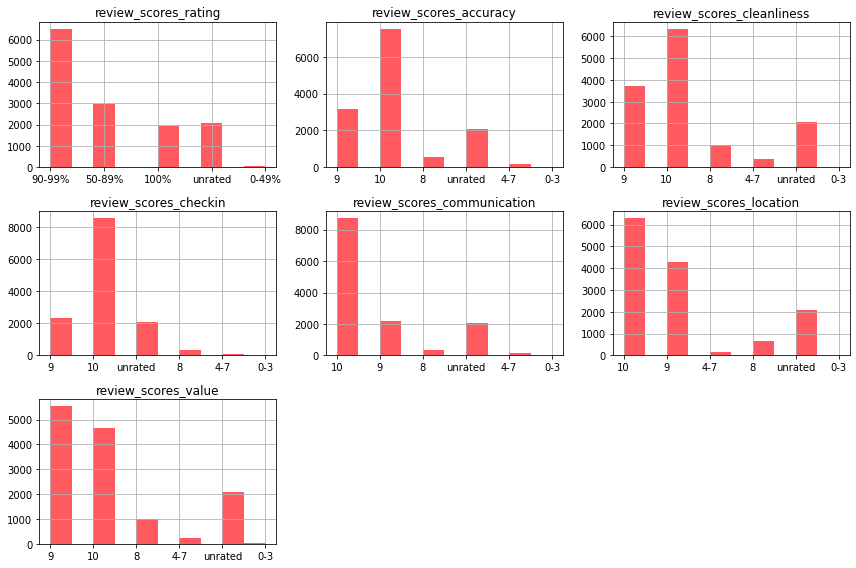

In [31]:
review_col = list(final.columns[final.columns.str.startswith("review_scores") == True])

fig = plt.figure(figsize=(12,8))
for i, var_name in enumerate(review_col):
    ax = fig.add_subplot(3,3,i+1)
    final[var_name].hist(bins=10, ax=ax, color = '#FF5A5F')
    ax.set_title(var_name)
    
fig.tight_layout()

In [32]:
review_group = pd.DataFrame(final.groupby('number_of_reviews').sum()['host_id'])
most_reviewed = (review_group.sort_values('number_of_reviews', ascending=False)).head(10)
most_reviewed['total_reviews'] = most_reviewed.index
most_reviewed.reset_index(drop=True, inplace=True)
most_reviewed

,host_id,total_reviews
0,209813314,529
1,206086589,526
2,150672186,488
3,21004633,475
4,194869594,407
5,219387975,347
6,6606987,339
7,205162345,330
8,6606987,319
9,85418859,317


---
## 3. Geographical Analysis

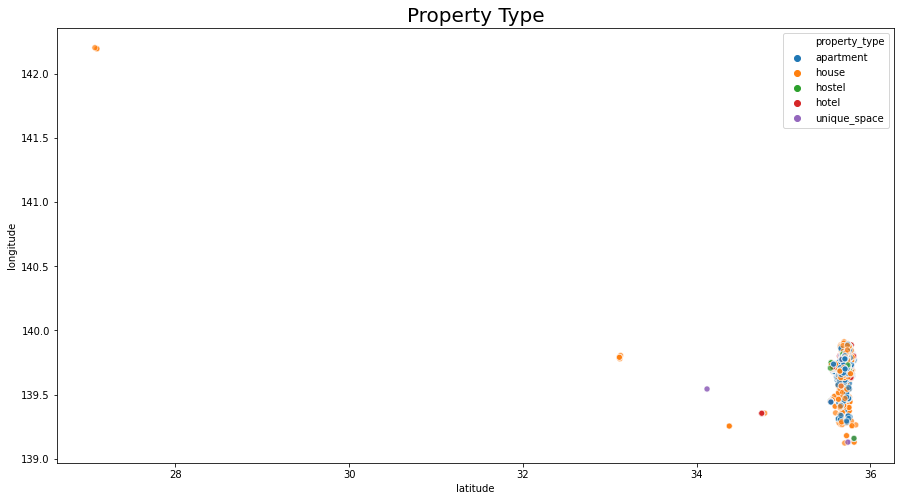

In [33]:
plt.figure(figsize=(15,8))
sns.scatterplot(x = 'latitude', 
                y = 'longitude', 
                hue = 'property_type', 
                data = final, 
                alpha = 0.7)
plt.title("Property Type", fontsize=20);

Judging from the this scatter plot, there is some listings that are pretty out of norm (based on latitude and longitute. Hence I will be dropping those.

In [34]:
final.drop(final[final.latitude < 35].index, inplace=True)

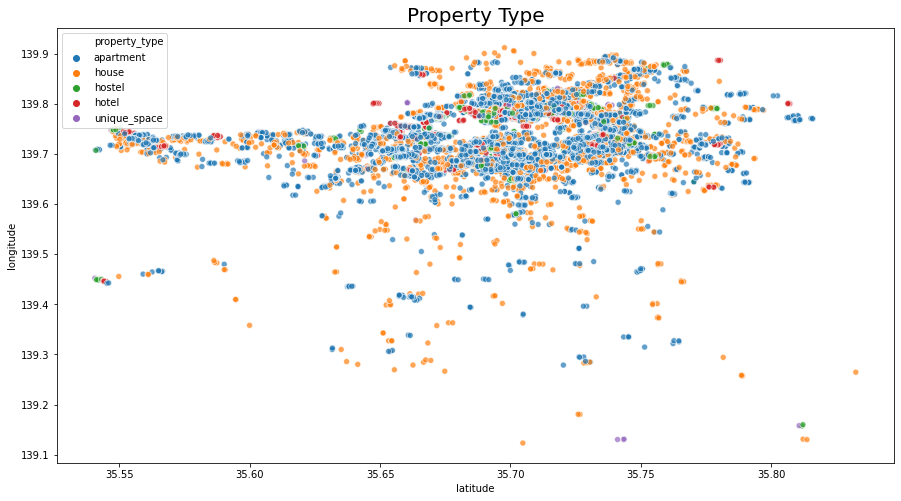

In [35]:
# plot scatter
plt.figure(figsize=(15,8))
sns.scatterplot(x = 'latitude', 
                y = 'longitude', 
                hue = 'property_type', 
                data = final, 
                alpha = 0.7)
plt.title("Property Type", fontsize=20);

After dropping those unusual listings this scatter plot above, there seem to be some listings that are still pretty out of norm. And it seem like not all listings are in Tokyo itself. 

In fact there are 23 wards called Special Cities within the Tokyo Metropolitan area, and each of them is further divided into districts. Hence I will just focus on neighbourhood feature that consist of 'ku'. Hence, I will be dropping those with 'shi'

![Tokyo Special Wards](https://upload.wikimedia.org/wikipedia/commons/0/09/Tokyo_special_wards_map_de.svg)

In [36]:
print(f'Total number of neighbourhood {final.neighbourhood.nunique()}')
final.neighbourhood.unique()

Total number of neighbourhood 50


array(['Shibuya Ku', 'Sumida Ku', 'Nerima Ku', 'Setagaya Ku',
       'Shinjuku Ku', 'Adachi Ku', 'Katsushika Ku', 'Meguro Ku',
       'Mitaka Shi', 'Koto Ku', 'Shinagawa Ku', 'Minato Ku',
       'Suginami Ku', 'Akishima Shi', 'Taito Ku', 'Toshima Ku',
       'Itabashi Ku', 'Ota Ku', 'Edogawa Ku', 'Arakawa Ku', 'Machida Shi',
       'Kita Ku', 'Higashimurayama Shi', 'Chuo Ku', 'Nakano Ku',
       'Kokubunji Shi', 'Hino Shi', 'Bunkyo Ku', 'Hachioji Shi',
       'Musashino Shi', 'Koganei Shi', 'Kodaira Shi', 'Akiruno Shi',
       'Chiyoda Ku', 'Fuchu Shi', 'Fussa Shi', 'Tama Shi',
       'Nishitokyo Shi', 'Komae Shi', 'Chofu Shi', 'Hinohara Mura',
       'Ome Shi', 'Kunitachi Shi', 'Okutama Machi', 'Higashiyamato Shi',
       'Hamura Shi', 'Tachikawa Shi', 'Musashimurayama Shi', 'Inagi Shi',
       'Higashikurume Shi'], dtype=object)

In [37]:
final =  final[~final.neighbourhood.str.contains(" Shi")]
final =  final[~final.neighbourhood.str.contains(" Mura")]
final =  final[~final.neighbourhood.str.contains(" Machi")]

print(f'Total number of neighbourhood: {final.neighbourhood.nunique()}')
print(f"Total Number of Listings Remaining: {final.shape[0]}")

Total number of neighbourhood: 23
Total Number of Listings Remaining: 13206


---
## 4. Geospatial Analysis

In [38]:
# Read files
tokyo_geo = gpd.read_file('../datasets/japan/neighbourhoods.geojson')
tokyo_geo = tokyo_geo[['neighbourhood','geometry']]

locs_geometry = [Point(xy) for xy in zip(final.longitude, final.latitude)]

crs = {'init': 'epsg:4326'}

locs_gdf = gpd.GeoDataFrame(final, 
                            crs = crs, 
                            geometry = locs_geometry)

##### 4.1. Property Type

In [39]:
# Setting basemap
tokyo = folium.Map(location=[35.6762, 139.6503], 
                   zoom_start=11, 
                   control_scale=True, 
                   tiles='cartodbpositron')

feature_apt = folium.FeatureGroup(name = 'Apartment')
feature_house = folium.FeatureGroup(name = 'House')
feature_hostel = folium.FeatureGroup(name = 'Hostel')
feature_hotel = folium.FeatureGroup(name = 'Hotel')
feature_unique = folium.FeatureGroup(name = 'Unique Space')

for i, v in locs_gdf.iterrows():
    if v['property_type'] == 'apartment':
        folium.CircleMarker(location=[v['latitude'], v['longitude']], 
                            radius = 1, 
                            color = '#00A699', 
                            fill_color = '#00A699', 
                            fill = True).add_to(feature_apt)
        
    elif v['property_type'] == 'house':
        folium.CircleMarker(location=[v['latitude'], v['longitude']], 
                            radius = 1, 
                            color = '#FF5A5F', 
                            fill_color = '#FF5A5F', 
                            fill = True).add_to(feature_house)
        
    elif v['property_type'] == 'hostel':
        folium.CircleMarker(location=[v['latitude'], v['longitude']], 
                            radius = 1, 
                            color = '#FC642D', 
                            fill_color = '#FC642D', 
                            fill = True).add_to(feature_hostel)   
        
    elif v['property_type'] == 'hotel':
        folium.CircleMarker(location=[v['latitude'], v['longitude']], 
                            radius = 1, 
                            color = '#484848', 
                            fill_color = '#484848', 
                            fill = True).add_to(feature_hotel)    

    elif v['property_type'] == 'unique_space':
        folium.CircleMarker(location=[v['latitude'], v['longitude']], 
                            radius = 1, 
                            color = '#767676', 
                            fill_color = '#767676', 
                            fill = True).add_to(feature_unique)   
        

        
feature_apt.add_to(tokyo)
feature_house.add_to(tokyo)
feature_hostel.add_to(tokyo)
feature_hotel.add_to(tokyo)
feature_unique.add_to(tokyo)

folium.LayerControl().add_to(tokyo)
tokyo

##### 4.2. Room Type

In [40]:
# Setting basemap
tokyo = folium.Map(location=[35.6762, 139.6503], 
                   zoom_start=11, 
                   control_scale=True, 
                   tiles='cartodbpositron')

feature_pr = folium.FeatureGroup(name = 'Private Room')
feature_ea = folium.FeatureGroup(name = 'Entire Home/Apt')
feature_sr = folium.FeatureGroup(name = 'Shared Room')
feature_hr = folium.FeatureGroup(name = 'Hotel Room')

for i, v in locs_gdf.iterrows():
    if v['room_type'] == 'private_room':
        folium.CircleMarker(location=[v['latitude'], v['longitude']], 
                            radius = 1, 
                            color = '#00A699', 
                            fill_color = '#00A699', 
                            fill = True).add_to(feature_pr)
        
    elif v['room_type'] == 'entire_home_apt':
        folium.CircleMarker(location=[v['latitude'], v['longitude']], 
                            radius = 1, 
                            color = '#FF5A5F', 
                            fill_color = '#FF5A5F', 
                            fill = True).add_to(feature_ea)
        
    elif v['room_type'] == 'shared_room':
        folium.CircleMarker(location=[v['latitude'], v['longitude']], 
                            radius = 1, 
                            color = '#FC642D', 
                            fill_color = '#FC642D', 
                            fill = True).add_to(feature_sr)   
        
    elif v['room_type'] == 'hotel_room':
        folium.CircleMarker(location=[v['latitude'], v['longitude']], 
                            radius = 1, 
                            color = '#484848', 
                            fill_color = '#484848', 
                            fill = True).add_to(feature_hr)    
        
feature_pr.add_to(tokyo)
feature_ea.add_to(tokyo)
feature_sr.add_to(tokyo)
feature_hr.add_to(tokyo)
folium.LayerControl().add_to(tokyo)
tokyo

According to the two geospatial map above, the most common listings are apartments (such as, condominium, aparthotel, service apartment, loft, etc) and entire home or apartment. There mostly concentrated at the center Japan, Tokyo

##### 4.3. Listing Density

In [41]:
tokyo = folium.Map(location=[35.6762, 139.6503], zoom_start=11, control_scale=True, tiles='cartodbpositron')

# Adding a heatmap to the base map
HeatMap(data=final[['latitude', 'longitude']], radius=10).add_to(tokyo)

# Displaying the map
tokyo

##### 4.4. Average Price Density

The following code have been taken from: 
https://github.com/Jan-Majewski/Project_Portfolio/blob/master/03_Real_Estate_pricing_in_Warsaw/03_02_Data_Vizualization.ipynb

In [42]:
#rounding coordinates by chosen precision creates a grid
rounding_num = 0.015 
final["lon_mod"] = np.round(final.longitude/rounding_num,0)*rounding_num

#adjusting for difference in actual distance between same numeric change in lat and lon to create a square grid
correction_coeff = 0.5
final["lat_mod"] = np.round(final.latitude/(rounding_num*correction_coeff),0)*(rounding_num*correction_coeff)
final["lon_mod"] = np.round(final["lon_mod"],4)
final["lat_mod"] = np.round(final["lat_mod"],4)

# Creating grid dataframe with average unit prices for each tile.
final_map = final[["lat_mod",
                   "lon_mod",
                   "log_price"]].groupby(["lat_mod","lon_mod"], as_index=False).mean()

final_map["sample_size"] = final[["lat_mod",
                                  "lon_mod",
                                  "id"]].groupby(["lat_mod","lon_mod"], as_index=False).count().id
final_map.reset_index(inplace=True)
final_map["geo_Id"] = final_map.index

In [43]:
#Selecting a central city point to center all graphs around 
center_coors = 35.6762, 139.6503


data = []
trace0 = dict(lat = final_map.lat_mod,
              lon = final_map.lon_mod,
              type = "scattermapbox",
              mode = 'markers',
              marker = dict(size = 17, 
                          color = final_map.log_price,
                          opacity = 0.6,
                          colorscale = "jet",
                          cauto = False,
                            cmax = 10.5,
                          showscale = True),
              text = final_map.log_price,
            
           
            )



data=[trace0]

layout = go.Layout(title = "Grid average price density [PLN/m2]",  
                   title_x = 0.4,
                   height = 800,
                   margin = dict(t = 80, b = 0, l = 0, r = 0),
                   mapbox = dict(center = dict(lat = center_coors[0],
                                               lon = center_coors[1]),
                                 zoom = 10,
                                 style = "carto-positron")
                  )

figure=dict(data=data,
            layout=layout)

iplot(figure)

From listing density, most listings are mostly concentrated in areas that are shown in red.
The purple areas are the lighter region where the data is available less, which means there are less customers/space in those regions. As expected, those listings are of high listing price. However, the difference in price based on location might not be as significant as seen in the map above, which is not very distinctive.

## 5. Heatmap of Correlation Matrix

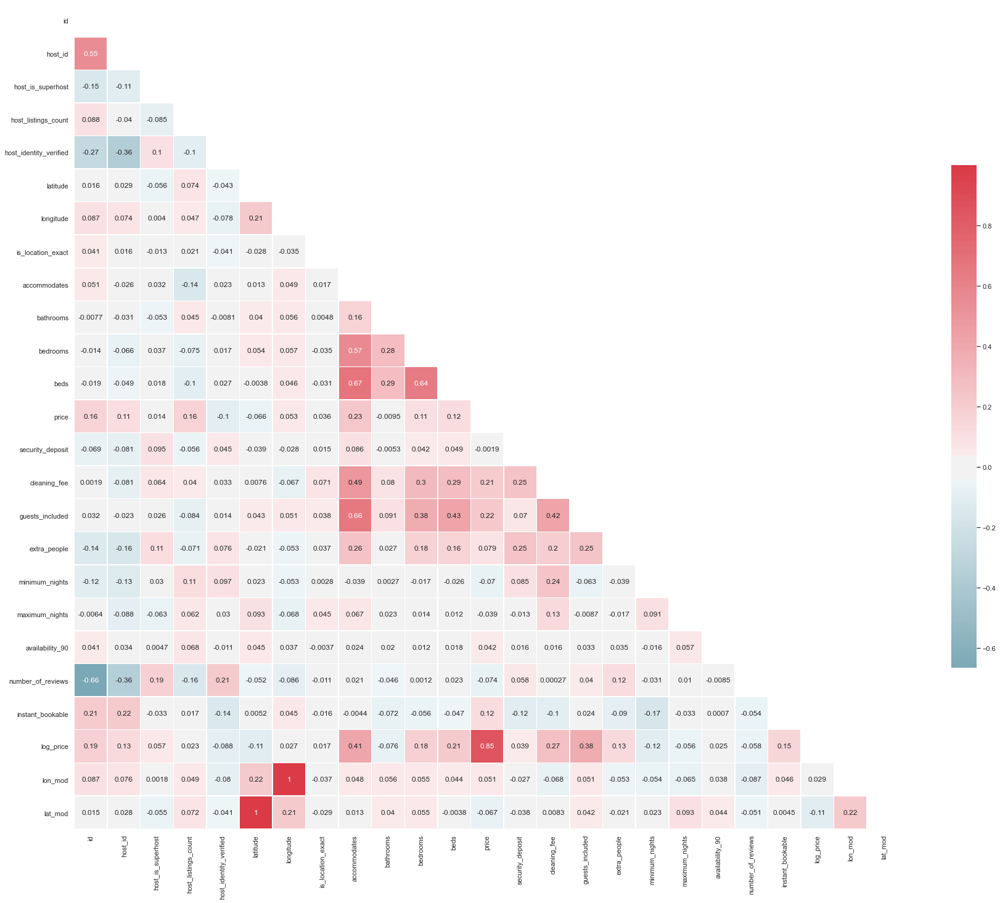

In [44]:
sns.set(style="white")

corr = final.corr()

mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

fig, ax = plt.subplots(figsize=(30,30))

cmap = sns.diverging_palette(220, 10, as_cmap=True)

sns.heatmap(corr, 
            mask=mask, 
            cmap=cmap, 
            center=0, 
            annot=True,
            square=True, 
            linewidths=.5, 
            cbar_kws={"shrink": .5});

As expected price correlated with cleaning_fee, guest_included and extra_people, host_listing_count, accomodation, bedroom and beds.

---
##### Save Final Dataframe

In [45]:
final.to_csv("../datasets/final_df.csv", index = False)

<---- Go back to the previous notebook [Data Cleaning and EDA](./01_Data_Cleaning_and_EDA.ipynb)

----> Proceed to the next notebook for [Feature Engineering and Model Benchmarks](./03_Feature_Engineering_and_Model_Benchmarks.ipynb)